<a href="https://colab.research.google.com/github/neochristou/line2picture/blob/master/line2picture_cs1470.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from glob import glob
import cv2
import numpy as np
from matplotlib import pyplot as plt
import datetime

In [ ]:
# Download data
!rm -r lfw*
!wget http://vis-www.cs.umass.edu/lfw/lfw.tgz
!tar xzvf /content/lfw.tgz
!rm -r data
!mkdir data

Streaming output truncated to the last 5000 lines.
lfw/Luis_Sanchez/Luis_Sanchez_0001.jpg
lfw/Juliette_Binoche/
lfw/Juliette_Binoche/Juliette_Binoche_0001.jpg
lfw/Joel_Todd/
lfw/Joel_Todd/Joel_Todd_0001.jpg
lfw/Allan_Wagner/
lfw/Allan_Wagner/Allan_Wagner_0001.jpg
lfw/Alejandro_Fernandez/
lfw/Alejandro_Fernandez/Alejandro_Fernandez_0001.jpg
lfw/Guillaume_Depardieu/
lfw/Guillaume_Depardieu/Guillaume_Depardieu_0001.jpg
lfw/Delphine_Chuillot/
lfw/Delphine_Chuillot/Delphine_Chuillot_0001.jpg
lfw/Paul_LeClerc/
lfw/Paul_LeClerc/Paul_LeClerc_0001.jpg
lfw/Eddie_Jordan/
lfw/Eddie_Jordan/Eddie_Jordan_0001.jpg
lfw/Lionel_Richie/
lfw/Lionel_Richie/Lionel_Richie_0001.jpg
lfw/Lionel_Richie/Lionel_Richie_0002.jpg
lfw/Jose_Viegas_Filho/
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0001.jpg
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0002.jpg
lfw/Roger_Mahony/
lfw/Roger_Mahony/Roger_Mahony_0001.jpg
lfw/Clay_Aiken/
lfw/Clay_Aiken/Clay_Aiken_0001.jpg
lfw/Clay_Aiken/Clay_Aiken_0002.jpg
lfw/Clay_Aiken/Clay_Aiken_000

In [ ]:
# General parameters
TRAINING_SPLIT = 3/4
IMG_WIDTH = 256
IMG_HEIGHT = 256
CHANNELS = 3
BATCH_SIZE = 1

# From pix2pix paper Section 3.3
LEARNING_RATE = 0.0002
BETA_1 = 0.5
BETA_2 = 0.999

# From pix2pix paper Section 4.4
LOSS_LAMBDA = 10

# From pix2pix paper Section 6.2
JITTER_RESIZE = 286

# From pix2pix paper Section 6.1
CONV_KERNEL_SIZE = 4
CONV_STRIDE_SIZE = 2
DROPOUT_RATE = 0.5
LEAKY_RELU_SLOPE = 0.2

# From pix2pix paper Section 6.2
WEIGHT_INIT_MEAN = 0.0
WEIGHT_INIT_STDEV = 0.02

# From pix2pix paper Section 6.1.1
GEN_ENCODER_LAYER_1_FILTERS = 64
GEN_ENCODER_LAYER_2_FILTERS = 128
GEN_ENCODER_LAYER_3_FILTERS = 256
GEN_ENCODER_LAYER_4_FILTERS = 512
GEN_ENCODER_LAYER_5_FILTERS = 512
GEN_ENCODER_LAYER_6_FILTERS = 512
GEN_ENCODER_LAYER_7_FILTERS = 512
GEN_ENCODER_LAYER_8_FILTERS = 512

GEN_DECODER_LAYER_1_FILTERS = 512
GEN_DECODER_LAYER_2_FILTERS = 512
GEN_DECODER_LAYER_3_FILTERS = 512
GEN_DECODER_LAYER_4_FILTERS = 512
GEN_DECODER_LAYER_5_FILTERS = 256
GEN_DECODER_LAYER_6_FILTERS = 128
GEN_DECODER_LAYER_7_FILTERS = 64

# From pix2pix paper Section 6.1.2
DISC_LAYER_1_FILTERS = 64
DISC_LAYER_2_FILTERS = 128
DISC_LAYER_3_FILTERS = 256
DISC_LAYER_4_FILTERS = 512

weight_initializer = tf.random_normal_initializer(WEIGHT_INIT_MEAN, WEIGHT_INIT_STDEV)
binary_xent = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
# Create outlines
original_image_filenames = glob("/content/lfw/*/*jpg")
for filename in original_image_filenames:
  original = cv2.imread(filename)
  # Upscale to 256 x 256
  original = cv2.resize(original, (IMG_WIDTH, IMG_HEIGHT))
  gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
  gray_smooth = cv2.bilateralFilter(gray, 7, 60, 60)
  outline = cv2.Canny(gray_smooth, 50, 50, apertureSize = 3, L2gradient = False)
  gray_outline = cv2.add(gray, outline)
  outline_result = np.stack((outline,) * 3, axis=-1)
  # Concatenate original image with outline for easier loading and save
  concat_result = cv2.hconcat([original, outline_result])
  out_filename = 'data/' + filename.split('/')[-1]
  cv2.imwrite(out_filename, concat_result)

In [ ]:
def load_pair_from_filename(filename):
  '''Helper function that loads an original image/outline pair'''

  # print(f"Loading {filename}")
  pair_image = tf.io.read_file(filename)
  pair_image = tf.io.decode_jpeg(pair_image)
  pair_image = tf.image.resize(pair_image, [IMG_WIDTH, IMG_HEIGHT * 2],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  outline_image = pair_image[:, IMG_HEIGHT:, :]
  original_image = pair_image[:, :IMG_HEIGHT, :]

  original_image = tf.cast(original_image, tf.float32)
  outline_image = tf.cast(outline_image, tf.float32)

  # print(f"Loaded {original_image.shape}")
  return outline_image, original_image


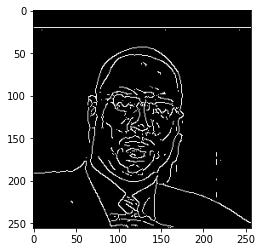

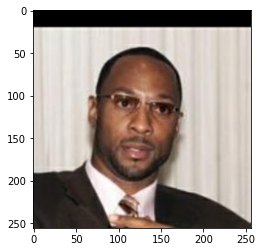

In [ ]:
sample_filename = glob('data/*.jpg')[700]
outline_image, original_image = load_pair_from_filename(sample_filename)
plt.figure()
plt.imshow(outline_image / 255.0)
plt.figure()
plt.imshow(original_image / 255.0)

In [ ]:
def resize(outline_image, original_image, height, width):
  outline_image = tf.image.resize(outline_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  original_image = tf.image.resize(original_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return outline_image, original_image


def random_crop(outline_image, original_image):
  stacked_image = tf.stack([outline_image, original_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, CHANNELS])

  return cropped_image[0], cropped_image[1]


def normalize(outline_image, original_image):
  outline_image = (outline_image / 127.5) - 1
  original_image = (original_image / 127.5) - 1

  return outline_image, original_image


In [ ]:
@tf.function()
def apply_random_jitter(outline_image, original_image):
  '''Resize to 286 x 286 and randomly crop back to 256 x 256 (Section 6.2 of the paper)'''
  outline_image, original_image = resize(outline_image, original_image, JITTER_RESIZE, JITTER_RESIZE)
  outline_image, original_image = random_crop(outline_image, original_image)

  return outline_image, original_image

In [ ]:
def load_train_pair(image_file):
  outline_image, original_image = load_pair_from_filename(image_file)
  outline_image, original_image = apply_random_jitter(outline_image, original_image)
  outline_image, original_image = normalize(outline_image, original_image)
  # outline_image, _ = tf.linalg.normalize(outline_image)
  # original_image, _ = tf.linalg.normalize(original_image)
  
  return outline_image, original_image

In [ ]:
def load_test_pair(image_file):
  outline_image, original_image = load_pair_from_filename(image_file)
  outline_image, original_image = normalize(outline_image, original_image)
  # outline_image, _ = tf.linalg.normalize(outline_image)
  # original_image, _ = tf.linalg.normalize(original_image)
  
  return outline_image, original_image

In [ ]:
# Split into training/testing data
images = glob('data/*.jpg')
training_split_cutoff = int(len(images) * TRAINING_SPLIT)
training_data_filenames = images[:training_split_cutoff]
testing_data_filenames = images[training_split_cutoff:]
print(len(training_data_filenames))
print(len(testing_data_filenames))
# print(training_data_filenames)
# print(testing_data_filenames)

9924
3309


In [ ]:
# Build datasets
training_data = tf.data.Dataset.list_files(training_data_filenames)
training_data = training_data.map(load_train_pair, num_parallel_calls=tf.data.AUTOTUNE)
training_data = training_data.batch(BATCH_SIZE)
print(training_data)
testing_data = tf.data.Dataset.list_files(testing_data_filenames)
testing_data = testing_data.map(load_test_pair, num_parallel_calls=tf.data.AUTOTUNE)
testing_data = testing_data.batch(BATCH_SIZE)
print(testing_data)

<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>
<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, None), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, None), dtype=tf.float32, name=None))>


In [ ]:
def line2pix_encoder_layer(num_filters, slope=LEAKY_RELU_SLOPE, is_first_layer=False):
  '''Encoder architecture described in Section 6.1 of pix2pix paper'''

  # Per Section 6.1.1, no Batch Normalization is applied to the first layer
  if not is_first_layer:
    layer = tf.keras.Sequential([
      tf.keras.layers.Conv2D(num_filters, CONV_KERNEL_SIZE, strides=CONV_STRIDE_SIZE, 
                             padding='same', kernel_initializer=weight_initializer, use_bias=False),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=slope),
    ])
  else:
      layer = tf.keras.Sequential([
      tf.keras.layers.Conv2D(num_filters, CONV_KERNEL_SIZE, strides=CONV_STRIDE_SIZE, 
                             padding='same', kernel_initializer=weight_initializer, use_bias=False),
      tf.keras.layers.LeakyReLU(alpha=slope)
    ])
      
  return layer

In [ ]:
def line2pix_decoder_layer(num_filters, apply_dropout=False):
  '''Decoder architecture described in Section 6.1 of pix2pix paper'''

  if apply_dropout:
    layer = tf.keras.Sequential([
        tf.keras.layers.Conv2DTranspose(num_filters, CONV_KERNEL_SIZE, strides=CONV_STRIDE_SIZE,
                                      padding='same', kernel_initializer=weight_initializer,
                                      use_bias=False),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.Dropout(DROPOUT_RATE),
      tf.keras.layers.ReLU()
    ])
  else:
    layer = tf.keras.Sequential([
      tf.keras.layers.Conv2DTranspose(num_filters, CONV_KERNEL_SIZE, strides=CONV_STRIDE_SIZE,
                                    padding='same', kernel_initializer=weight_initializer,
                                    use_bias=False),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.ReLU()
    ])
  
  return layer

In [ ]:
class Generator(tf.keras.Model):

  def __init__(self):

    super(Generator, self).__init__()

    # self.optimizer = tf.keras.optimizers.Adam(LEARNING_RATE, beta_1=BETA_1, beta_2=BETA_2)

    self.encoder1 = line2pix_encoder_layer(GEN_ENCODER_LAYER_1_FILTERS, is_first_layer=True)
    self.encoder2 = line2pix_encoder_layer(GEN_ENCODER_LAYER_2_FILTERS)
    self.encoder3 = line2pix_encoder_layer(GEN_ENCODER_LAYER_3_FILTERS)
    self.encoder4 = line2pix_encoder_layer(GEN_ENCODER_LAYER_4_FILTERS)
    self.encoder5 = line2pix_encoder_layer(GEN_ENCODER_LAYER_5_FILTERS)
    self.encoder6 = line2pix_encoder_layer(GEN_ENCODER_LAYER_6_FILTERS)
    self.encoder7 = line2pix_encoder_layer(GEN_ENCODER_LAYER_7_FILTERS)
    self.encoder8 = line2pix_encoder_layer(GEN_ENCODER_LAYER_8_FILTERS)

    self.decoder1 = line2pix_decoder_layer(GEN_DECODER_LAYER_1_FILTERS, apply_dropout=True)
    self.decoder2 = line2pix_decoder_layer(GEN_DECODER_LAYER_2_FILTERS)
    self.decoder3 = line2pix_decoder_layer(GEN_DECODER_LAYER_3_FILTERS)
    self.decoder4 = line2pix_decoder_layer(GEN_DECODER_LAYER_4_FILTERS)
    self.decoder5 = line2pix_decoder_layer(GEN_DECODER_LAYER_5_FILTERS)
    self.decoder6 = line2pix_decoder_layer(GEN_DECODER_LAYER_6_FILTERS)
    self.decoder7 = line2pix_decoder_layer(GEN_DECODER_LAYER_7_FILTERS)

    self.last = tf.keras.layers.Conv2DTranspose(CHANNELS, CONV_KERNEL_SIZE,
                                                strides=CONV_STRIDE_SIZE,
                                                padding='same',
                                                kernel_initializer=weight_initializer,
                                                activation='tanh')
  def call(self,outline_image):

    # Implement skip connections (Section 3.2.1) to enable better flow 
    # of information between the generator layers
    skips = []

    out = self.encoder1(outline_image)
    skips.append(out)
    out = self.encoder2(out)
    skips.append(out)
    out = self.encoder3(out)
    skips.append(out)
    out = self.encoder4(out)
    skips.append(out)
    out = self.encoder5(out)
    skips.append(out)
    out = self.encoder6(out)
    skips.append(out)
    out = self.encoder7(out)
    skips.append(out)
    out = self.encoder8(out)
    skips.append(out)

    skips = list(reversed(skips[:-1]))

    out = self.decoder1(out)
    out = tf.keras.layers.Concatenate()([out, skips[0]])
    out = self.decoder2(out)
    out = tf.keras.layers.Concatenate()([out, skips[1]])
    out = self.decoder3(out)
    out = tf.keras.layers.Concatenate()([out, skips[2]])
    out = self.decoder4(out)
    out = tf.keras.layers.Concatenate()([out, skips[3]])
    out = self.decoder5(out)
    out = tf.keras.layers.Concatenate()([out, skips[4]])
    out = self.decoder6(out)
    out = tf.keras.layers.Concatenate()([out, skips[5]])
    out = self.decoder7(out)
    out = tf.keras.layers.Concatenate()([out, skips[6]])

    out = self.last(out)
    return out

  def loss(self, discrim_image, generator_image, original_image):
    gan_loss = binary_xent(tf.ones_like(discrim_image), discrim_image)
    l1_loss = tf.reduce_mean(tf.abs(original_image - generator_image))
    total_gen_loss = gan_loss + (LOSS_LAMBDA * l1_loss)
    return total_gen_loss

generator_optimizer = tf.keras.optimizers.Adam(LEARNING_RATE, beta_1=BETA_1, beta_2=BETA_2)


In [ ]:
class Discriminator(tf.keras.Model):

  def __init__(self):

    super(Discriminator, self).__init__()

    # self.optimizer = tf.keras.optimizers.Adam(LEARNING_RATE, beta_1=BETA_1, beta_2=BETA_2)

    self.disc_layer_1 = line2pix_encoder_layer(DISC_LAYER_1_FILTERS, slope=0.3, is_first_layer=True)
    self.disc_layer_2 = line2pix_encoder_layer(DISC_LAYER_2_FILTERS, slope=0.3)
    self.disc_layer_3 = line2pix_encoder_layer(DISC_LAYER_3_FILTERS, slope=0.3)
    self.disc_layer_4 = line2pix_encoder_layer(DISC_LAYER_4_FILTERS, slope=0.3)
    # self.zero_pad1 = tf.keras.layers.ZeroPadding2D()
    # self.disc_layer_4 = tf.keras.layers.Conv2D(DISC_LAYER_4_FILTERS, CONV_KERNEL_SIZE, strides=1,
    #                             kernel_initializer=weight_initializer,
    #                             use_bias=False)
    # self.batchnorm = tf.keras.layers.BatchNormalization()
    # self.leaky_relu = tf.keras.layers.LeakyReLU()
    # self.zero_pad2 = tf.keras.layers.ZeroPadding2D()

    self.final_conv_layer = tf.keras.layers.Conv2D(1, CONV_KERNEL_SIZE, strides=1,
                                kernel_initializer=weight_initializer)
  def call(self, inp, tar):
    out = tf.keras.layers.concatenate([inp, tar])
    out = self.disc_layer_1(out) 
    out = self.disc_layer_2(out) 
    out = self.disc_layer_3(out) 

    out = self.disc_layer_4(out)
    # out = self.zero_pad1(out)
    # out = self.disc_layer_4(out)
    # out = self.batchnorm(out)
    # out = self.leaky_relu(out)
    # out = self.zero_pad2(out)

    out = self.final_conv_layer(out)
    return out

  def loss(self, original_img_pred, gen_img_pred):  

    real_loss = binary_xent(tf.ones_like(original_img_pred), original_img_pred)
    generated_loss = binary_xent(tf.zeros_like(gen_img_pred), gen_img_pred)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss

discriminator_optimizer = tf.keras.optimizers.Adam(LEARNING_RATE, beta_1=BETA_1, beta_2=BETA_2)


In [ ]:
def generate_image_from_outline(generator, outline_img, original_img):
  '''Get an image from the Generator and plot the outline, original
  image and generated image'''

  prediction = generator(outline_img, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [outline_img[0], original_img[0], prediction[0]]
  title = ['Outline', 'Original Image', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

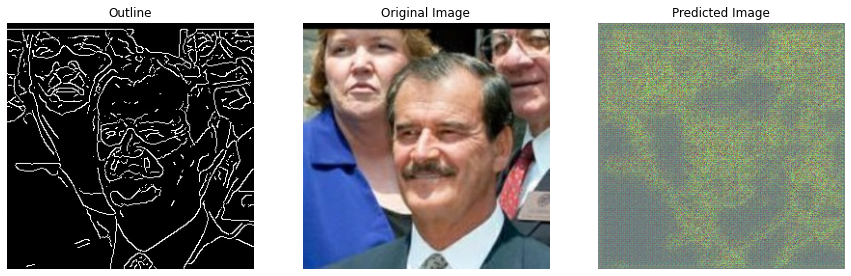

Step: 0, Generator loss: 5.640537261962891, Disriminator loss: 1.3810491561889648


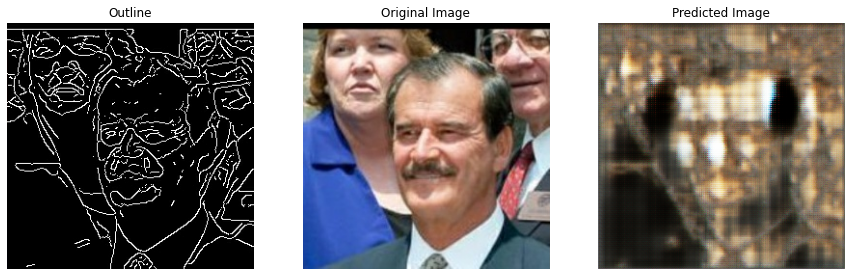

Step: 500, Generator loss: 7.206254005432129, Disriminator loss: 1.3578836917877197


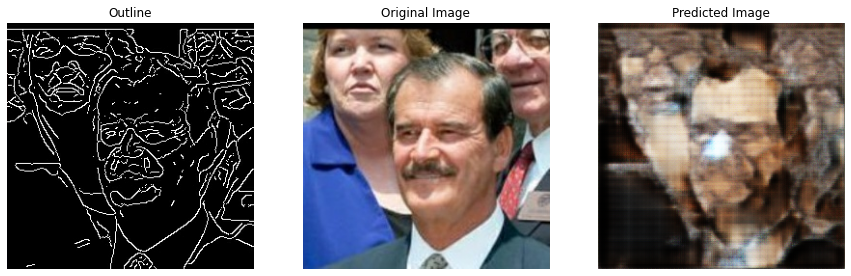

Step: 1000, Generator loss: 4.974327087402344, Disriminator loss: 1.0352247953414917


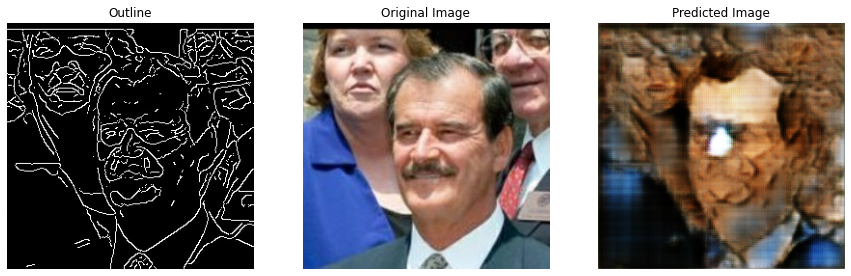

Step: 1500, Generator loss: 4.38715934753418, Disriminator loss: 1.3671281337738037


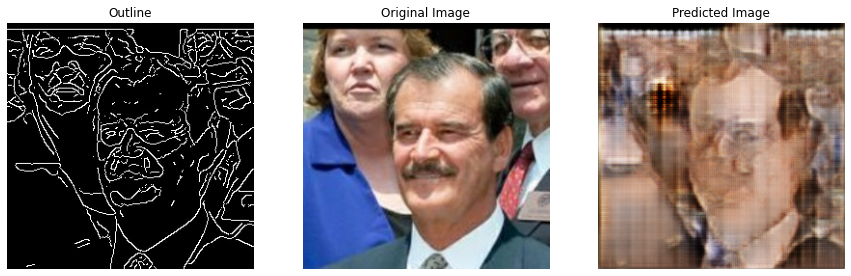

Step: 2000, Generator loss: 6.361851215362549, Disriminator loss: 1.106339931488037


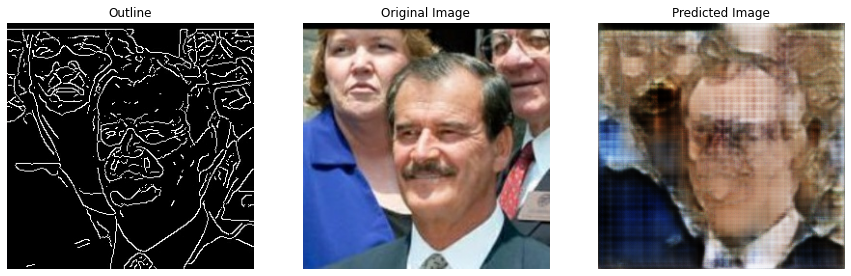

Step: 2500, Generator loss: 4.639895439147949, Disriminator loss: 1.1597274541854858


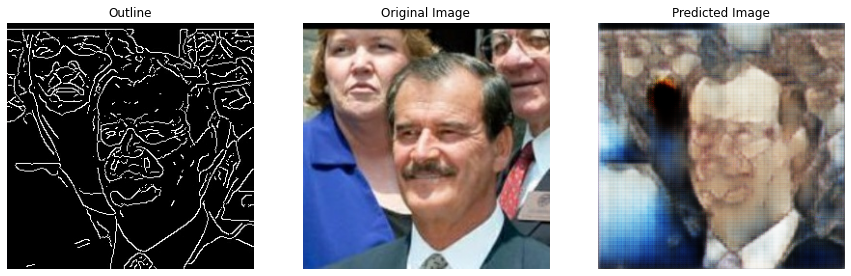

Step: 3000, Generator loss: 5.851560115814209, Disriminator loss: 1.0089653730392456


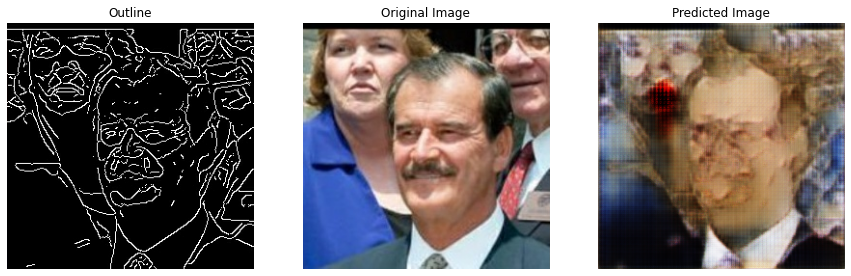

Step: 3500, Generator loss: 5.8263020515441895, Disriminator loss: 0.9658390283584595


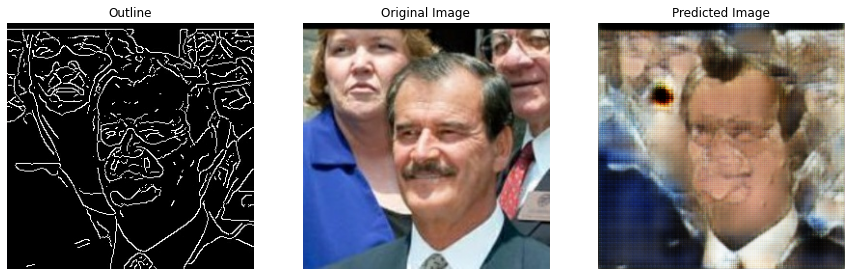

Step: 4000, Generator loss: 4.6584858894348145, Disriminator loss: 0.9295744299888611


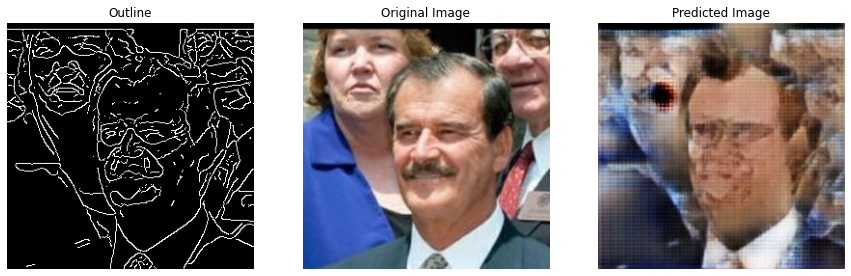

Step: 4500, Generator loss: 5.910833835601807, Disriminator loss: 0.5372422933578491


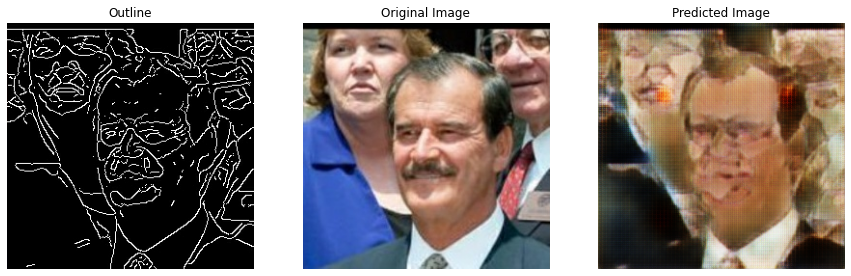

Step: 5000, Generator loss: 5.301220417022705, Disriminator loss: 1.033372163772583


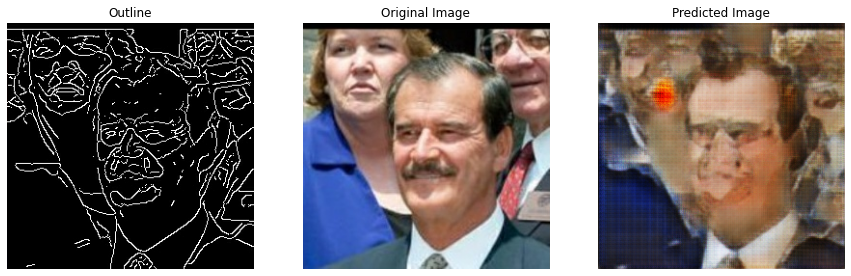

Step: 5500, Generator loss: 5.211704730987549, Disriminator loss: 0.9154480695724487


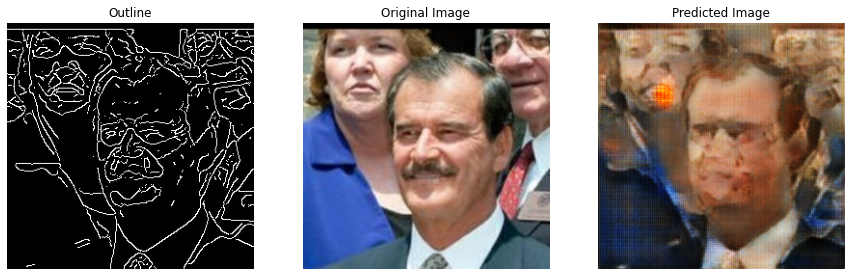

Step: 6000, Generator loss: 3.864285707473755, Disriminator loss: 0.7212470769882202


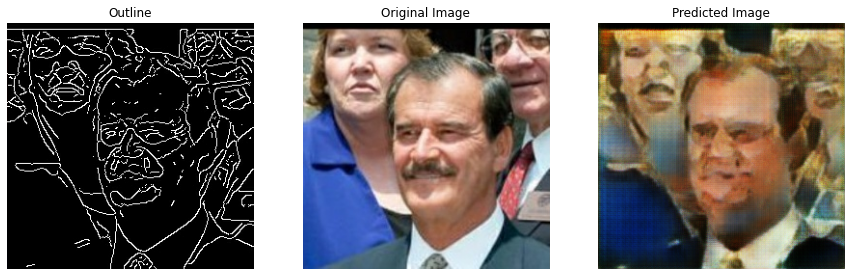

Step: 6500, Generator loss: 3.3610219955444336, Disriminator loss: 0.9440107345581055


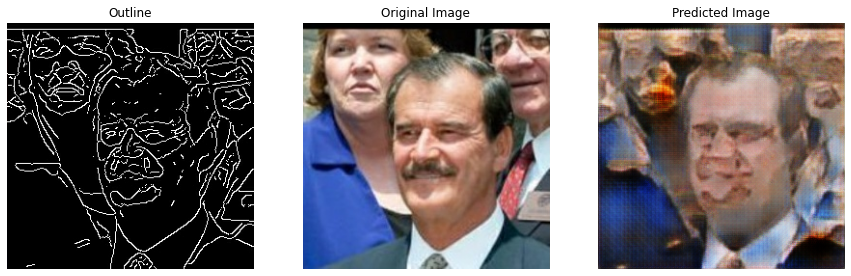

Step: 7000, Generator loss: 5.628053188323975, Disriminator loss: 0.7543455362319946


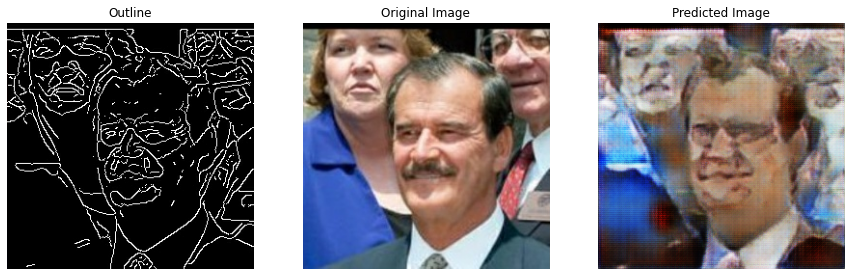

Step: 7500, Generator loss: 11.646305084228516, Disriminator loss: 1.1156419515609741


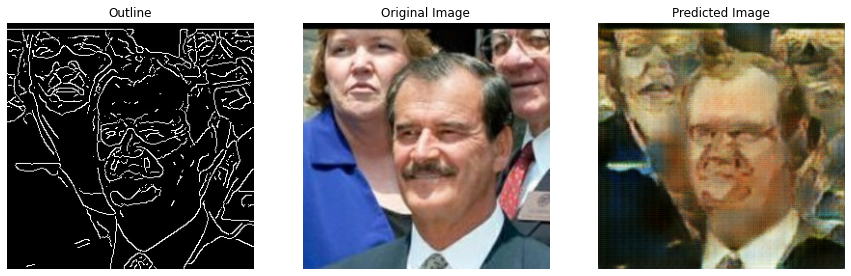

Step: 8000, Generator loss: 5.5704145431518555, Disriminator loss: 0.6315616965293884


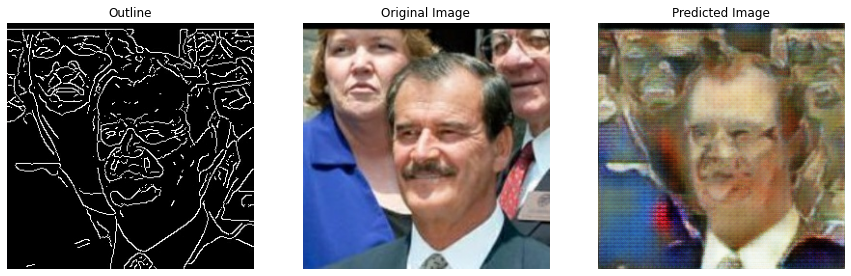

Step: 8500, Generator loss: 10.669805526733398, Disriminator loss: 0.5916033387184143


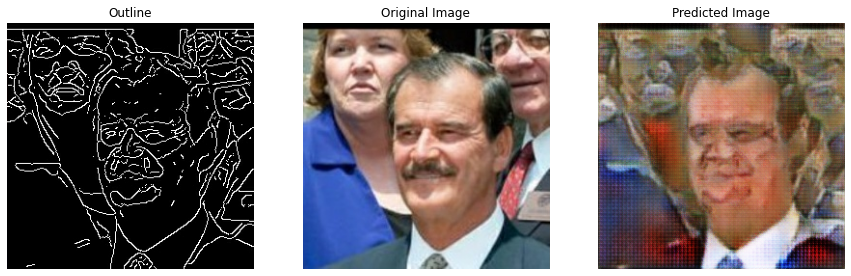

Step: 9000, Generator loss: 11.190486907958984, Disriminator loss: 0.3205682039260864


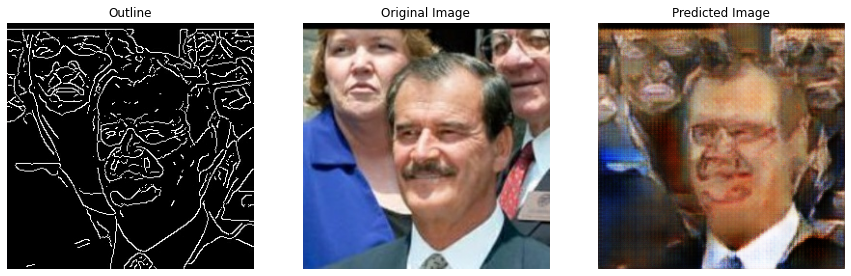

Step: 9500, Generator loss: 8.265256881713867, Disriminator loss: 0.6770128011703491


In [ ]:
@tf.function
def train_step(outline_image, original_image):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(outline_image, training=True)

    disc_real_output = discriminator(outline_image, original_image)
    disc_generated_output = discriminator(outline_image, gen_output)

    gen_total_loss = generator.loss(disc_generated_output, gen_output, original_image)
    disc_loss = discriminator.loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  return gen_total_loss, disc_loss

def train(training_data, testing_data, steps):

  # Get a sample to see the progress of our generator
  sample_outline_img, sample_original_img = next(iter(testing_data.take(1)))

  for step, (outline_image, original_image) in training_data.repeat().take(steps).enumerate():
    
    gen_loss, disc_loss = train_step(outline_image, original_image)
    train_step(outline_image, original_image)
    # Check how much the generator has learned every few steps
    if (step) % 500 == 0:
      generate_image_from_outline(generator, sample_outline_img, sample_original_img)
      print(f"Step: {step}, Generator loss: {gen_loss}, Disriminator loss: {disc_loss}")
      
      with summary_writer.as_default():
        tf.summary.scalar('gen_loss', gen_loss, step=step)
        tf.summary.scalar('disc_loss', disc_loss, step=step)


current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_dir = 'logs/' + current_time
summary_writer = tf.summary.create_file_writer(log_dir)

generator = Generator()
discriminator = Discriminator()
train(training_data, testing_data, steps=len(training_data))

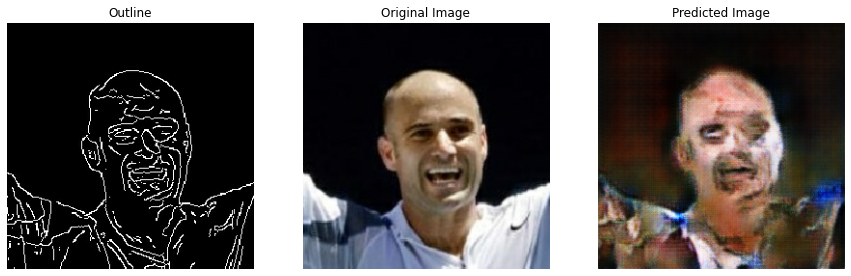

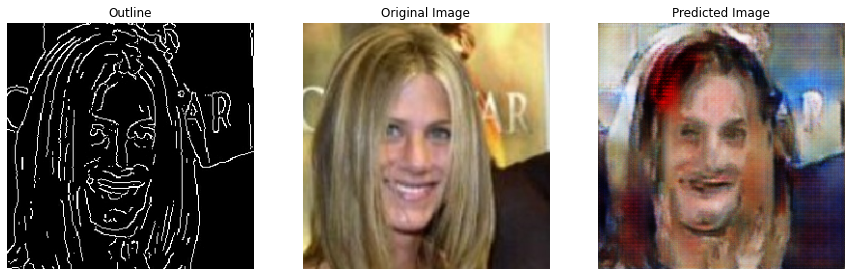

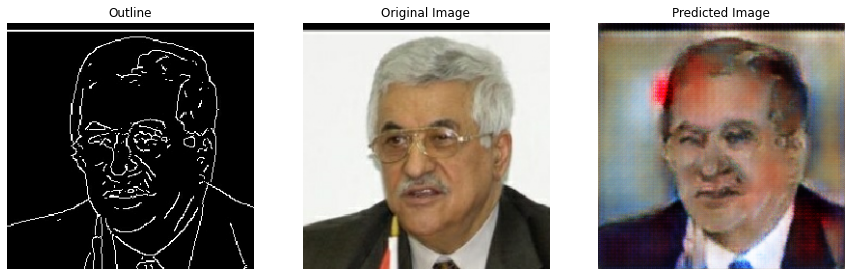

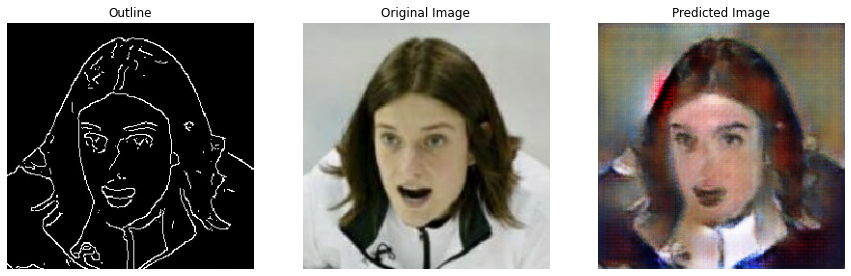

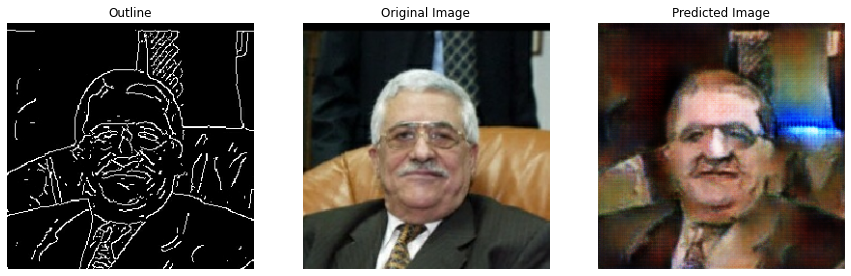

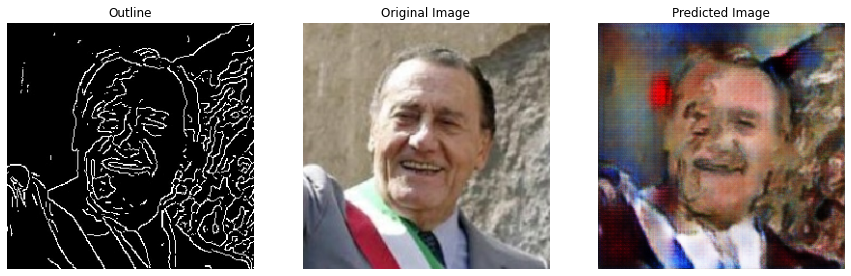

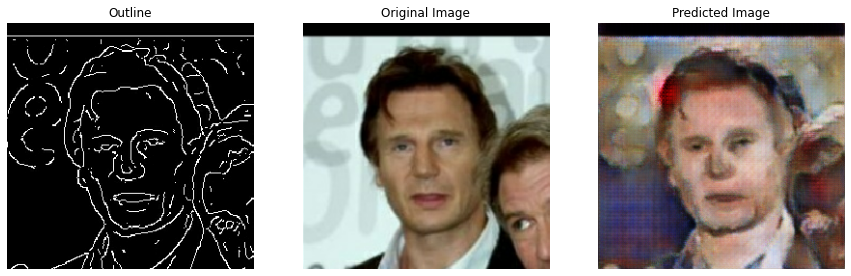

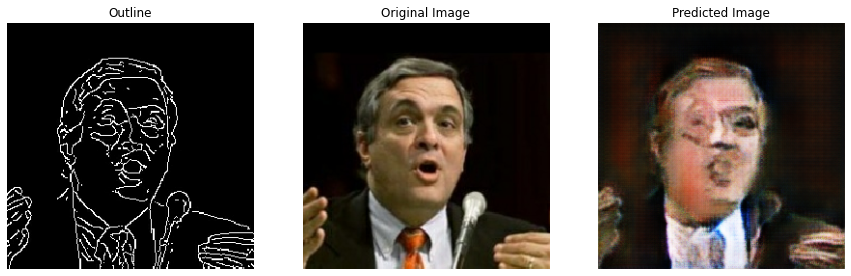

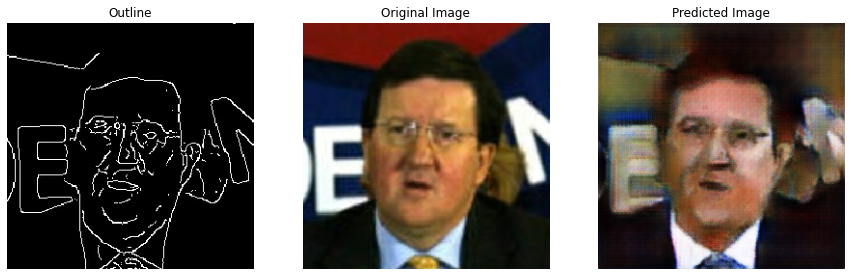

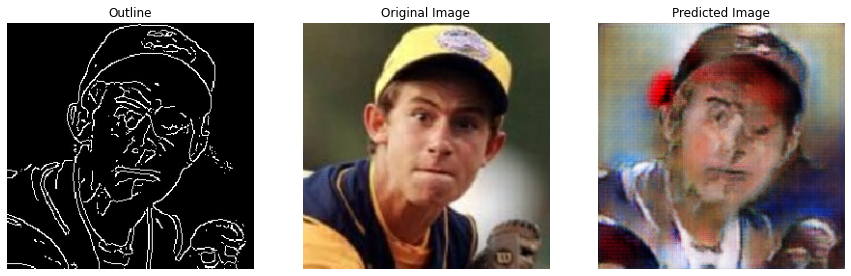

In [ ]:
for (outline_image, original_image) in training_data.take(10):
    generate_image_from_outline(generator, outline_image, original_image)


In [ ]:
# Save the models
!mkdir -p saved_model
generator.save('saved_model/generator') 
discriminator.save('saved_model/discriminator') 

INFO:tensorflow:Assets written to: saved_model/generator/assets
INFO:tensorflow:Assets written to: saved_model/discriminator/assets


In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

Evaluation Metric

In [ ]:
a = []
g = []
for inp, tar in testing_data.take(10):
  gen = generator(inp, training= True)
  a.append(tar[0])
  g.append(gen[0])

In [ ]:
from scipy.linalg import sqrtm
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input

def calculate_fid(model, images1, images2):
	# calculate activations
	images1 = preprocess_input(images1)
	images2 = preprocess_input(images2)
	act1 = model.predict(images1)
	act2 = model.predict(images2)
	# calculate mean and covariance statistics
	mu1, sigma1 = act1.mean(axis=0), np.cov(act1, rowvar=False)
	mu2, sigma2 = act2.mean(axis=0), np.cov(act2, rowvar=False)
	# calculate sum squared difference between means
	ssdiff = np.sum((mu1 - mu2)**2.0)
	# calculate sqrt of product between cov
	covmean = sqrtm(sigma1.dot(sigma2))
 
	# check and correct imaginary numbers from sqrt
	if np.iscomplexobj(covmean):
		covmean = covmean.real
	# calculate score
	fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
	return fid
 
# prepare the inception v3 model
model = InceptionV3(include_top=False, pooling='avg', input_shape=(256,256,3))

87924736/87910968 [==============================] - 1s 0us/step


In [ ]:
calculate_fid(model, tf.stack(a), tf.stack(g))

24.0833871201167